In [19]:
%pip install geopandas --user
%pip install folium --user

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [20]:
import geopandas as gpd
import folium

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from multiprocessing import Pool
from itertools import islice
from pathlib import Path

In [21]:
pwd = Path.cwd()

# GPKG of spain 
fname = 'dep_pop_geom_Spain.gpkg'
fpath = pwd / fname

# Coordinates of Climbing centers
fname = 'spain_climbing_locations.csv'
csvname = pwd / fname

In [22]:
# Read in Files
spain_coord = pd.read_csv(csvname)
spain_geom = gpd.read_file(fpath, layer='2021')

In [23]:
# Visualization of Spain GPKG
m = folium.Map(location=[40.4637, -3.7492], zoom_start=6)

choropleth_layer = folium.Choropleth(
    geo_data=spain_geom,
    data=spain_geom,  
    columns=['name_dep', 'density'],
    key_on='feature.properties.name_dep',  # Adjust this to match your GeoDataFrame properties
    fill_opacity=0.6,
    line_opacity=0.2,
    legend_name='Population Density'
)

choropleth_layer.add_to(m)

tooltip = folium.GeoJsonTooltip(fields=['name_dep', 'density', 'population', 'area'], labels=True, sticky=False)

choropleth_layer.geojson.add_child(tooltip)

m

In [24]:
from climbing2 import get_coordinates

coordinates = get_coordinates(csvname)
    
for coordinate, name in coordinates.items():
    
    popup_text = f"""
    <strong>{name}</strong><br>
    """
    
    circle = folium.Circle(
            location=list(coordinate),
            color='blue',
            fill=True,
            fill_color='red',
            fill_opacity=0.6,
            popup=popup_text)
    circle.add_to(m)

m

In [25]:
geo_arrray = gpd.points_from_xy(spain_coord.lon, spain_coord.lat)  
gdf_coords = gpd.GeoDataFrame(spain_coord, geometry=geo_arrray)
gdf_coords.set_crs(epsg=4326, inplace=True) # setting CRS to EPSG 4326 in place 

gdf_boundaries = gpd.read_file(fpath) # get boundaries of Spanish Comunidades Autonomas
gdf_small = gdf_boundaries.drop(columns=['geometry'])

In [26]:
gdf_small.head().to_html(index=False, classes='table table-striped')

'<table border="1" class="dataframe table table-striped">\n  <thead>\n    <tr style="text-align: right;">\n      <th>GID_1</th>\n      <th>name_dep</th>\n      <th>code_dep</th>\n      <th>population</th>\n      <th>density</th>\n      <th>area</th>\n    </tr>\n  </thead>\n  <tbody>\n    <tr>\n      <td>ESP.1_1</td>\n      <td>Andalucía</td>\n      <td>ES.AN</td>\n      <td>8464411</td>\n      <td>96</td>\n      <td>87268.0</td>\n    </tr>\n    <tr>\n      <td>ESP.2_1</td>\n      <td>Aragón</td>\n      <td>ES.AR</td>\n      <td>1329391</td>\n      <td>28</td>\n      <td>47719.0</td>\n    </tr>\n    <tr>\n      <td>ESP.3_1</td>\n      <td>Cantabria</td>\n      <td>ES.CB</td>\n      <td>582905</td>\n      <td>109</td>\n      <td>5321.0</td>\n    </tr>\n    <tr>\n      <td>ESP.4_1</td>\n      <td>Castilla-La Mancha</td>\n      <td>ES.CM</td>\n      <td>2045221</td>\n      <td>26</td>\n      <td>79463.0</td>\n    </tr>\n    <tr>\n      <td>ESP.5_1</td>\n      <td>Castilla y León</td>\n    

In [27]:
# Spatially join two GeoDataFrames
# keep left GeoDataFrame's geometry
# predicate='within' means that the points must be within the boundaries
gdf_joined = gpd.sjoin(gdf_coords, gdf_boundaries, how='left', predicate='within')

# Group by the name of the Comunidad Autonoma and count the number of climbing centers in each
state_counts = gdf_joined.groupby('name_dep').size().reset_index(name='counts')
state_counts = state_counts.merge(gdf_boundaries[['name_dep', 'density', 'area']], on='name_dep')

# Display the results
print(state_counts)


                      name_dep  counts  density     area
0                    Andalucía      15       96  87268.0
1                       Aragón       9       28  47719.0
2                    Cantabria       2      109   5321.0
3              Castilla y León       8       25  94223.0
4                     Cataluña      37      239  32114.0
5   Comunidad Foral de Navarra       6       63  10391.0
6         Comunidad Valenciana      26      215  23255.0
7          Comunidad de Madrid      22      830   8028.0
8                  Extremadura       4       26  41634.0
9                      Galicia       2       91  29574.0
10              Islas Baleares      21      230   4992.0
11              Islas Canarias       2      289   7447.0
12                    La Rioja       1       63   5045.0
13                  País Vasco      10      305   7234.0
14      Principado de Asturias       3       96  10604.0
15            Región de Murcia       4      132  11313.0


In [28]:
state_html = state_counts.to_html(index=False, classes='table table-striped')
cleaned_html_table = state_html.replace('\n', '')
cleaned_html_table

'<table border="1" class="dataframe table table-striped">  <thead>    <tr style="text-align: right;">      <th>name_dep</th>      <th>counts</th>      <th>density</th>      <th>area</th>    </tr>  </thead>  <tbody>    <tr>      <td>Andalucía</td>      <td>15</td>      <td>96</td>      <td>87268.0</td>    </tr>    <tr>      <td>Aragón</td>      <td>9</td>      <td>28</td>      <td>47719.0</td>    </tr>    <tr>      <td>Cantabria</td>      <td>2</td>      <td>109</td>      <td>5321.0</td>    </tr>    <tr>      <td>Castilla y León</td>      <td>8</td>      <td>25</td>      <td>94223.0</td>    </tr>    <tr>      <td>Cataluña</td>      <td>37</td>      <td>239</td>      <td>32114.0</td>    </tr>    <tr>      <td>Comunidad Foral de Navarra</td>      <td>6</td>      <td>63</td>      <td>10391.0</td>    </tr>    <tr>      <td>Comunidad Valenciana</td>      <td>26</td>      <td>215</td>      <td>23255.0</td>    </tr>    <tr>      <td>Comunidad de Madrid</td>      <td>22</td>      <td>830</td>  

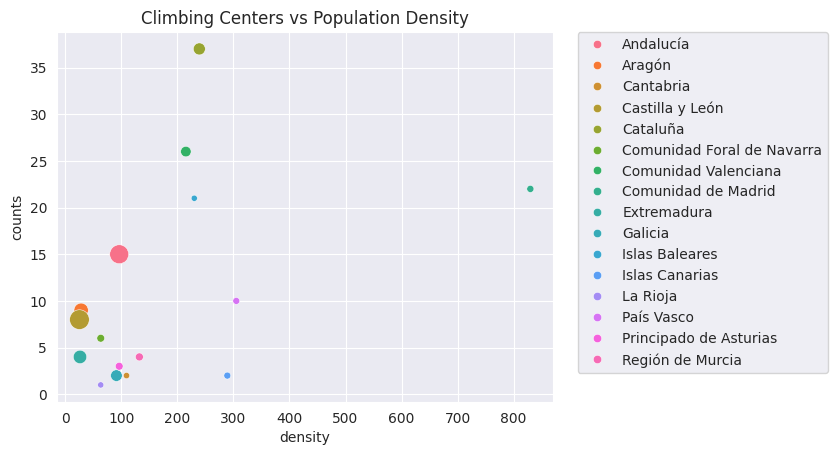

In [31]:
# scatter plot and R2
import seaborn as sns
sns.set_style("darkgrid")
ax = sns.scatterplot(data=state_counts, x='density', y='counts', size='area', hue='name_dep',sizes=(20, 200))
# for line in range(0,state_counts.shape[0]):
#      plt.text(state_counts.density[line]+1, state_counts.counts[line]+1, state_counts.name_dep[line], horizontalalignment='left', size='small', color='black', weight='semibold')
plt.title('Climbing Centers vs Population Density')
h, l = ax.get_legend_handles_labels()
ax.legend(h[1:len(state_counts.name_dep)+1], l[1:len(state_counts.name_dep)+1], bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., fontsize=10)

plt.savefig('climbing_centers_vs_population_density.png', dpi=300,  bbox_inches='tight')